# Human-Mammalian Brain - Basal Ganglia spatial transcriptomics cells

The basal ganglia are a set of subcortical structures critical for motor control, particularly in the context of action selection, motor learning and emotional state, whose coarse functional organization is well-described in the literature. Although single-cell RNA-Seq studies have greatly enhanced our understanding of cellular diversity in the brain, the exact spatial distribution of cell types within the brain has been difficult to determine. Using spatial transcriptomics platforms such as MERSCOPE or Xenium enables spatial profiling of hundreds of genes for each cell, enabling the mapping the cells to the **consensus basal ganglia cell type taxonomy.

You need to be connected to the internet to run this notebook and have run through the [getting started notebook](https://alleninstitute.github.io/abc_atlas_access/notebooks/getting_started.html).

In [1]:
from glob import glob
import os
from unittest.mock import patch
import json
import geojson

import pandas as pd
from pathlib import Path
import numpy as np
import anndata
import matplotlib.pyplot as plt
import matplotlib as mpl

from abc_atlas_access.abc_atlas_cache.abc_project_cache import AbcProjectCache
from abc_atlas_access.abc_atlas_cache.anndata_utils import get_gene_data

We will interact with the data using the **AbcProjectCache**. This cache object tracks which data has been downloaded and serves the path to the requested data on disk. For metadata, the cache can also directly serve a up a Pandas DataFrame. See the [``getting_started``](https://alleninstitute.github.io/abc_atlas_access/notebooks/getting_started.html) notebook for more details on using the cache including installing it if it has not already been.

**Change the download_base variable to where you have downloaded the data in your system.**

In [2]:
# download_base = Path('../../data/abc_atlas')
download_base = Path('/allen/programs/celltypes/workgroups/rnaseqanalysis/lydian/ABC_handoff')
abc_cache = AbcProjectCache.from_local_cache(download_base)

abc_cache.current_manifest

/allen/scratch/aibstemp/chris.morrison/src/abc_atlas_access/src/abc_atlas_access/abc_atlas_cache/cloud_cache.py:519: MissingLocalManifestWarning: This cache directory appears to contain data files, but it has no record of what those files are. Unless running as a LocalCache, files will be re-downloaded.
  warnings.warn(msg, MissingLocalManifestWarning)


'releases/20250630/manifest.json'

## Cell metadata

Each species in the HMBA spatial dataset comes has it's own h5ad files and associated cell metadata tables. We load each of these in turn starting from Human to Macaque to Marmoset.

Load the Human cells.

In [3]:
human_cell_metadata = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-H22.30.001-BG',
    file_name='cell_metadata',
    dtype={"cell_label": str}
).set_index('cell_label')
human_cell_metadata.head()

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,abc_atlas_visualization,dataset_label,feature_matrix_label
cell_label,,,,,,,,
1321115602_1-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,3285.3843,336.96967,False,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG
1321115602_2-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,4730.3096,354.69010,False,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG
1321115602_3-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,2966.4824,804.66986,False,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG
1321115602_4-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,3765.8542,704.11170,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG
1321115602_5-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,3763.5205,716.22940,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG


Load the Macaque cells.

In [4]:
macaque_cell_metadata = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-QM23.50.001-BG',
    file_name='cell_metadata',
    dtype={"cell_label": str}
).set_index('cell_label')
macaque_cell_metadata.head()

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,abc_atlas_visualization,dataset_label,feature_matrix_label
cell_label,,,,,,,,
1291813781_1-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6328.8564,271.71730,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG
1291813781_2-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6313.3560,297.27830,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG
1291813781_3-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6323.7240,297.38340,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG
1291813781_4-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6370.7470,377.92710,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG
1291813781_5-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6375.0240,386.81006,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG


Load the Marmoset cells.

In [5]:
marmoset_cell_metadata = abc_cache.get_metadata_dataframe(
    directory='HMBA-Xenium-CJ23.56.004-BG',
    file_name='cell_metadata',
    dtype={"cell_label": str}
).set_index('cell_label')
marmoset_cell_metadata.head()

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,abc_atlas_visualization,dataset_label,feature_matrix_label
cell_label,,,,,,,,
1382042951_abmkfncc-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,5923.492676,6160.654297,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG
1382042951_abmmdgea-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,6137.572266,6217.075684,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG
1382042951_abmojfce-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,5802.674805,5614.007812,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG
1382042951_abmomnim-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,5805.942383,5599.325684,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG
1382042951_aeiamgga-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,6291.268066,6068.720215,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG


Finally, we load data from the Zhuang mouse dataset that has been trimmed down based on their CCF coordniates to only cells that are in the Basal Ganglia.

In [6]:
mouse_cell_metadata = abc_cache.get_metadata_dataframe(
    directory='HMBA-Zhuang-ABCA-BG',
    file_name='cell_metadata',
    dtype={"cell_label": str}
).set_index('cell_label')
mouse_cell_metadata.head()

,brain_section_label,feature_matrix_label,donor_label,donor_genotype,donor_sex,cluster_alias,x,y,z,subclass_confidence_score,cluster_confidence_score,high_quality_transfer,abc_sample_id,dataset_label
cell_label,,,,,,,,,,,,,,
140326997007540545632825561480074910925,Zhuang-ABCA-1.089,Zhuang-ABCA-1-BG,Zhuang-ABCA-1,wt/wt,F,5231,3.856600,4.843804,7.82953,0.999973,0.999973,True,81d7533b-f702-4b8f-8037-69865381eee5,HMBA-Zhuang-ABCA-BG
189072533119855038043895242178779700246,Zhuang-ABCA-1.089,Zhuang-ABCA-1-BG,Zhuang-ABCA-1,wt/wt,F,5231,3.860636,4.911333,7.82953,0.999984,0.878835,True,e5fda034-0b07-4941-9f76-834f28ee4698,HMBA-Zhuang-ABCA-BG
209727608826968156867849253723759432014,Zhuang-ABCA-1.089,Zhuang-ABCA-1-BG,Zhuang-ABCA-1,wt/wt,F,5254,3.833809,4.825046,7.82953,0.999982,0.819572,True,56ba2b5c-08cb-4bf3-a876-8d3604336448,HMBA-Zhuang-ABCA-BG
256350117171596137374760944717720346108,Zhuang-ABCA-1.089,Zhuang-ABCA-1-BG,Zhuang-ABCA-1,wt/wt,F,5254,3.835581,4.866399,7.82953,0.999975,0.857229,True,40c00627-71f7-4140-a1ca-84c7323a6772,HMBA-Zhuang-ABCA-BG
67350765359712588341770079705746198475,Zhuang-ABCA-1.089,Zhuang-ABCA-1-BG,Zhuang-ABCA-1,wt/wt,F,5231,3.851189,4.840811,7.82953,0.999986,0.825559,True,863d5b45-2cea-41fe-9223-1d80c7a85701,HMBA-Zhuang-ABCA-BG


### Specimen metadata

In order to associate each cell to it's correct slide of the brain, we load the specimen table for each species. This provides a mapping for each cell to it's associated `slab_plane`. We'll explain more regarding the `slab_plane` when we load the our cells coordinates in the plane.

Below we load the Human specimen data.

In [7]:
human_specimen = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-H22.30.001-BG',
    file_name='specimen_metadata',
    dtype={"cell_label": str}
).set_index('brain_section_label')
human_specimen.head()

,brain_section_barcode,brain_section_thickness,brain_section_plane_of_section,brain_section_ordinal,brain_section_depth,section_set_label,section_set_ordinal,section_set_base_ordinal,brain_block_label,brain_block_number,brain_slab_label,brain_slab_ordinal,brain_slab_thickness,hemisphere,brain_division_label,brain_division_ordinal,donor_label,slab_plane_ordinal,slab_plane_label,slab_plane_order
brain_section_label,,,,,,,,,,,,,,,,,,,,
H22.30.001.BS.3.01.01.02,1327888285,14,transverse (rostral to caudal),74,1036,H22.30.001.BS.3.01.01,1,72,H22.30.001.BS.3.01,1,H22.30.001.BS.3,2,4.0,right,H22.30.001.BS,2,H22.30.001,1,H22.30.001.BS.3.Plane.01,20201
H22.30.001.BS.3.01.03.02,1327888566,14,transverse (rostral to caudal),109,1526,H22.30.001.BS.3.01.03,3,107,H22.30.001.BS.3.01,1,H22.30.001.BS.3,2,4.0,right,H22.30.001.BS,2,H22.30.001,3,H22.30.001.BS.3.Plane.03,20203
H22.30.001.BS.3.02.01.02,1327890979,14,transverse (rostral to caudal),37,518,H22.30.001.BS.3.02.01,1,35,H22.30.001.BS.3.02,2,H22.30.001.BS.3,2,4.0,right,H22.30.001.BS,2,H22.30.001,1,H22.30.001.BS.3.Plane.01,20201
H22.30.001.BS.3.02.03.03,1327891526,14,transverse (rostral to caudal),146,2044,H22.30.001.BS.3.02.03,3,143,H22.30.001.BS.3.02,2,H22.30.001.BS.3,2,4.0,right,H22.30.001.BS,2,H22.30.001,3,H22.30.001.BS.3.Plane.03,20203
H22.30.001.CX.13.01.03.02,1304618482,10,coronal (caudal to rostral),143,1430,H22.30.001.CX.13.01.03,3,141,H22.30.001.CX.13.01,1,H22.30.001.CX.13,13,4.0,right,H22.30.001.CX,1,H22.30.001,5,H22.30.001.CX.13.Plane.05,11305


The Macaque specimen table.

In [8]:
macaque_specimen = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-QM23.50.001-BG',
    file_name='specimen_metadata',
    dtype={"cell_label": str}
).set_index('brain_section_label')
macaque_specimen.head()

,brain_section_barcode,brain_section_thickness,brain_section_plane_of_section,brain_section_ordinal,brain_section_depth,section_set_label,section_set_ordinal,section_set_base_ordinal,brain_block_label,brain_block_number,brain_slab_label,brain_slab_ordinal,brain_slab_thickness,hemisphere,brain_division_label,brain_division_ordinal,donor_label,slab_plane_ordinal,slab_plane_label,slab_plane_order
brain_section_label,,,,,,,,,,,,,,,,,,,,
QM23.50.001.CX.42.01.03.02,1291809823,10,coronal (caudal to rostral),133,1330,QM23.50.001.CX.42.01.03,3,131,QM23.50.001.CX.42.01,1,QM23.50.001.CX.42,42,4.0,right,QM23.50.001.CX,1,QM23.50.001,5,QM23.50.001.CX.42.Plane.05,14205
QM23.50.001.CX.42.01.05.03,1291809799,10,coronal (caudal to rostral),234,2340,QM23.50.001.CX.42.01.05,5,231,QM23.50.001.CX.42.01,1,QM23.50.001.CX.42,42,4.0,right,QM23.50.001.CX,1,QM23.50.001,3,QM23.50.001.CX.42.Plane.03,14203
QM23.50.001.CX.42.02.03.02,1291810606,10,coronal (caudal to rostral),134,1340,QM23.50.001.CX.42.02.03,3,132,QM23.50.001.CX.42.02,2,QM23.50.001.CX.42,42,4.0,right,QM23.50.001.CX,1,QM23.50.001,5,QM23.50.001.CX.42.Plane.05,14205
QM23.50.001.CX.42.02.05.03,1291810584,10,coronal (caudal to rostral),234,2340,QM23.50.001.CX.42.02.05,5,231,QM23.50.001.CX.42.02,2,QM23.50.001.CX.42,42,4.0,right,QM23.50.001.CX,1,QM23.50.001,3,QM23.50.001.CX.42.Plane.03,14203
QM23.50.001.CX.42.02.07.03,1291810555,10,coronal (caudal to rostral),334,3340,QM23.50.001.CX.42.02.07,7,331,QM23.50.001.CX.42.02,2,QM23.50.001.CX.42,42,4.0,right,QM23.50.001.CX,1,QM23.50.001,1,QM23.50.001.CX.42.Plane.01,14201


And finally the Marmoset specimen table.

In [9]:
marmoset_specimen = abc_cache.get_metadata_dataframe(
    directory='HMBA-Xenium-CJ23.56.004-BG',
    file_name='specimen_metadata',
    dtype={"cell_label": str}
).set_index('brain_section_label')
marmoset_specimen.head()

,brain_section_barcode,brain_section_thickness,brain_section_plane_of_section,brain_section_ordinal,brain_section_depth,section_set_label,section_set_ordinal,section_set_base_ordinal,brain_block_label,brain_block_number,brain_slab_label,brain_slab_ordinal,brain_slab_thickness,hemisphere,brain_division_label,brain_division_ordinal,donor_label,slab_plane_ordinal,slab_plane_label,slab_plane_order
brain_section_label,,,,,,,,,,,,,,,,,,,,
CJ23.56.004.CX.42.01.06,1382042951,10,coronal (rostral to caudal),7,70,CJ23.56.004.CX.42.01,1,1,CJ23.56.004.CX.42,42,CJ23.56.004.CX.42,42,5.0,right,CJ23.56.004.CX,1,CJ23.56.004,1,CJ23.56.004.CX.42.Plane.01,14201
CJ23.56.004.CX.42.02.06,1382042748,10,coronal (rostral to caudal),27,270,CJ23.56.004.CX.42.02,2,21,CJ23.56.004.CX.42,42,CJ23.56.004.CX.42,42,5.0,right,CJ23.56.004.CX,1,CJ23.56.004,2,CJ23.56.004.CX.42.Plane.02,14202
CJ23.56.004.CX.42.03.07,1382042618,10,coronal (rostral to caudal),48,480,CJ23.56.004.CX.42.03,3,41,CJ23.56.004.CX.42,42,CJ23.56.004.CX.42,42,5.0,right,CJ23.56.004.CX,1,CJ23.56.004,3,CJ23.56.004.CX.42.Plane.03,14203
CJ23.56.004.CX.42.04.06,1382042399,10,coronal (rostral to caudal),67,670,CJ23.56.004.CX.42.04,4,61,CJ23.56.004.CX.42,42,CJ23.56.004.CX.42,42,5.0,right,CJ23.56.004.CX,1,CJ23.56.004,4,CJ23.56.004.CX.42.Plane.04,14204
CJ23.56.004.CX.42.05.06,1382042114,10,coronal (rostral to caudal),87,870,CJ23.56.004.CX.42.05,5,81,CJ23.56.004.CX.42,42,CJ23.56.004.CX.42,42,5.0,right,CJ23.56.004.CX,1,CJ23.56.004,5,CJ23.56.004.CX.42.Plane.05,14205


Join with the specimen with the cell metadata for each species.

In [10]:
macaque_cell_metadata = macaque_cell_metadata.join(macaque_specimen, on='brain_section_label', rsuffix='_specimen')
marmoset_cell_metadata = marmoset_cell_metadata.join(marmoset_specimen, on='brain_section_label', rsuffix='_specimen')
human_cell_metadata = human_cell_metadata.join(human_specimen, on='brain_section_label', rsuffix='_specimen')

## Spatial, slab-plane coordinates

We load the slab-plane coordinates for all of our cells. Each cell comes from a brain section that is a slice of a block cut from a cross-sectional slab of brain. The brain sections are spatially registered with the brain sections from the neighboring blocks within the brain slab. These associated brain sections are referred to a slab-plane. This slab-plane coordinate system in millimeters are the coordinates we will plot all of our cells in this notebook.

Again, we load the coordinates for each of the 3 different species.

In [11]:
human_cell_slab_plane_coordinates = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-H22.30.001-BG',
    file_name='slab_plane_coordinates',
    dtype={"cell_label": str}
).set_index('cell_label')
human_cell_slab_plane_coordinates.head()

,slab_plane_label,x_slab_mm,y_slab_mm
cell_label,,,
1321115602_1-20250227,H22.30.001.CX.16.Plane.05,19.435099,77.464922
1321115602_2-20250227,H22.30.001.CX.16.Plane.05,18.956184,76.119954
1321115602_3-20250227,H22.30.001.CX.16.Plane.05,19.982788,77.581815
1321115602_4-20250227,H22.30.001.CX.16.Plane.05,19.614409,76.879852
1321115602_5-20250227,H22.30.001.CX.16.Plane.05,19.626566,76.877390


In [12]:
macaque_cell_slab_plane_coordinates = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-QM23.50.001-BG',
    file_name='slab_plane_coordinates',
    dtype={"cell_label": str}
).set_index('cell_label')
macaque_cell_slab_plane_coordinates.head()

,slab_plane_label,x_slab_mm,y_slab_mm
cell_label,,,
1291813781_1-20250227,QM23.50.001.CX.44.Plane.07,49.982522,35.779509
1291813781_2-20250227,QM23.50.001.CX.44.Plane.07,49.986300,35.748134
1291813781_3-20250227,QM23.50.001.CX.44.Plane.07,49.976306,35.751906
1291813781_4-20250227,QM23.50.001.CX.44.Plane.07,49.896221,35.688888
1291813781_5-20250227,QM23.50.001.CX.44.Plane.07,49.888261,35.681598


In [13]:
marmoset_cell_slab_plane_coordinates = abc_cache.get_metadata_dataframe(
    directory='HMBA-Xenium-CJ23.56.004-BG',
    file_name='slab_plane_coordinates',
    dtype={"cell_label": str}
).set_index('cell_label')
marmoset_cell_slab_plane_coordinates.head()

,brain_section_label,slab_plane_label,x_slab_mm,y_slab_mm
cell_label,,,,
1382042951_abmkfncc-1-20250227,CJ23.56.004.CX.42.01.06,CJ23.56.004.CX.42.Plane.01,22.351041,13.197057
1382042951_abmmdgea-1-20250227,CJ23.56.004.CX.42.01.06,CJ23.56.004.CX.42.Plane.01,22.161344,13.311199
1382042951_abmojfce-1-20250227,CJ23.56.004.CX.42.01.06,CJ23.56.004.CX.42.Plane.01,22.313860,12.638454
1382042951_abmomnim-1-20250227,CJ23.56.004.CX.42.01.06,CJ23.56.004.CX.42.Plane.01,22.306610,12.625276
1382042951_aeiamgga-1-20250227,CJ23.56.004.CX.42.01.06,CJ23.56.004.CX.42.Plane.01,21.972238,13.211848


In [14]:
mouse_reconstructed_coords = []
for zhuang_idx in range(1, 5):
    dataset_label = f'Zhuang-ABCA-{zhuang_idx}-CCF'
    dataset_coords = abc_cache.get_metadata_dataframe(
        directory=dataset_label,
        file_name='ccf_coordinates',
        dtype={"cell_label": str}
    ).set_index('cell_label')
    mouse_reconstructed_coords.append(
        dataset_coords[dataset_coords.index.isin(mouse_cell_metadata.index)]
    )
    
mouse_reconstructed_coords = pd.concat(mouse_reconstructed_coords)
mouse_reconstructed_coords.head()

,x,y,z,parcellation_index
cell_label,,,,
140326997007540545632825561480074910925,7.857000,5.211115,3.632223,371
189072533119855038043895242178779700246,7.848060,5.299934,3.641897,914
209727608826968156867849253723759432014,7.859488,5.189339,3.606767,303
256350117171596137374760944717720346108,7.854045,5.243704,3.611273,914
67350765359712588341770079705746198475,7.857403,5.207875,3.626235,303


In [15]:
mouse_cell_metadata = mouse_cell_metadata.join(
    mouse_reconstructed_coords,
    how='inner',
    rsuffix='_ccf'
)

And finally we join them into their respective cell metadata.

In [16]:
human_cell_metadata = human_cell_metadata.join(
    human_cell_slab_plane_coordinates[['x_slab_mm', 'y_slab_mm']], how='inner'
)
macaque_cell_metadata = macaque_cell_metadata.join(
    macaque_cell_slab_plane_coordinates[['x_slab_mm', 'y_slab_mm']], how='inner'
)
marmoset_cell_metadata = marmoset_cell_metadata.join(
    marmoset_cell_slab_plane_coordinates[['x_slab_mm', 'y_slab_mm']], how='inner'
)
mouse_cell_metadata = mouse_cell_metadata.join(
    mouse_reconstructed_coords,
    how='inner',
    rsuffix='_ccf'
)

### Geojson polygons

The dataset includes polygons outlining regions of the Basal Ganglia that can be plotted over the slab coordinates. These are provided in [geojson](https://geojson.org/) format. We use the associated python package to load the jsons for use in our analysis.

First though, we load the term set for these data. This provides colors and plotting order that we can use in our figures.

In [17]:
value_sets = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-H22.30.001-BG',
    file_name='value_sets',
)
pred = value_sets['field'] == 'parcellation_term_symbol'
parcellation_terms = value_sets[pred].copy()
parcellation_terms.set_index('label', inplace=True)
parcellation_terms

,table,field,description,order,external_identifier,parent_label,color_hex_triplet,comment,Column1,Column2,Column3,Column4
label,,,,,,,,,,,,
Basal ganglia and adjacent,path,parcellation_term_symbol,Basal ganglia and adjacent,1,basal_ganglia_and_adjacent,NaN,#808080,gray,NaN,NaN,NaN,NaN
Subcortical,path,parcellation_term_symbol,Subcortical,2,subcortical,NaN,#E0E0E0,lightgray,NaN,NaN,NaN,NaN
Midline,path,parcellation_term_symbol,Midline,3,midline,NaN,#E3BE8A,orange,NaN,NaN,NaN,NaN
STR,path,parcellation_term_symbol,striatum,4,DHBA:10333,Basal ganglia and adjacent,#cd86cc,red,NaN,NaN,NaN,NaN
Ca,path,parcellation_term_symbol,caudate nucleus,5,DHBA:10334,NaN,#ff6b9a,orange,NaN,NaN,NaN,NaN
Pu,path,parcellation_term_symbol,putamen,6,DHBA:10338,NaN,#9BA2FF,green,NaN,NaN,NaN,NaN
GP,path,parcellation_term_symbol,globus pallidus,7,DHBA:10342,Basal ganglia and adjacent,#7AE361,blue,NaN,NaN,NaN,NaN
GPe,path,parcellation_term_symbol,external segment of globus pallidus,8,DHBA:10343,Basal ganglia and adjacent,#53DB33,navy,NaN,NaN,NaN,NaN
GPi,path,parcellation_term_symbol,internal segment of globus pallidus,9,DHBA:10344,Basal ganglia and adjacent,#A7DB33,lightblue,NaN,NaN,NaN,NaN


Below we define two functions that will be used in our plotting of the geojsons. The first takes in the data and a matplotlib axis object and plots the geojson data on the provided axis, extracting color and name information from the value/term set. The second loads the data based on the appropriate slab and species provided.

In [18]:
def plot_geo_data(geo_data, ax, terms=parcellation_terms):
    """Plot a geojson polygon over the input axis.

    Parameters
    ----------
    geo_data: dict
        Geojson formated dictionary containing Polygons to plot.
    ax: matplotlib.pyplot.axis
        Axis object to plot the geosjon data over.
    terms: pandas.DataFrame
        Term list containing the colors and orders for the parcellation, brain region trems. 
    """
    if geo_data is None:
        return None
    if geo_data['type'] == 'FeatureCollection':
        for sub_data in geo_data['features']:
            plot_geo_data(sub_data, ax)
    elif geo_data['type'] == 'Feature':
        geometry_data = geo_data['geometry']
        name = geo_data['properties']['label']
        color = terms.loc[name, 'color_hex_triplet']
        if geometry_data['type'] == 'GeometryCollection':
            for idx, geometry in enumerate(geometry_data['geometries']):
                coords = np.array(list(geojson.coords(geometry)))
                if idx == 0:
                    ax.fill(coords[:, 0],
                            coords[:, 1],
                            edgecolor=color,
                            fill=False,
                            linewidth=2,
                            label=name)
                else:
                    ax.fill(coords[:, 0],
                            coords[:, 1],
                            edgecolor=color,
                            fill=False,
                            linewidth=2)
        else:
            coords = np.array(list(geojson.coords(geometry_data)))
            try:
                ax.fill(coords[:, 0],
                        coords[:, 1],
                        edgecolor=color,
                        fill=False,
                        linewidth=2,
                        label=name)
            except ValueError:
                import pdb; pdb.set_trace()
    else:
        print("unknown data", geo_data)

def get_polygons(slab_name, species):

    if species == 'macaque':
        base_dir = 'HMBA-MERSCOPE-QM23.50.001-BG'
    elif species == 'marmoset':
        base_dir = 'HMBA-Xenium-CJ23.56.004-BG'
    elif species == 'human':
        base_dir = 'HMBA-MERSCOPE-H22.30.001-BG'
    else:
        raise ValueError('Invalid species')

    file_path = abc_cache.get_file_path(directory=base_dir, file_name=slab_name)
    if not file_path.exists():
        return None

    with open(file_path) as jfile:
        data = json.load(jfile)
    
    return data

### Plotting the Slabs

We define a helper function *plot_slabs* to visualize the cells for a specified set of brain sections either by colorized metadata or gene expression.

In [19]:
def plot_slabs(
    df,
    feature,
    slab_list,
    species,
    cmap=None,
    fig_width=40,
    fig_height=8,
    plot_polygons=False,
    point_size=1.0,
    fix_bounds=False
):
    """Plot spatial transcriptomics data.

    Parameters
    ----------
    df: pandas.DataFrame
        cell metadata data frame with x,y locations to plot.
    feature: str
        Expression value or color column to plot.
    slab_list: List[str]
        List of slab_plane ids to plot.
    species: str
        Species to plot (human, macaque, marmoset).
    cmap: matplotlib.colors.Colormap
        Colormap for expression features.
    fid_width: int
        Width of the plotted figure.
    fig_height: iont
        Height of the plotted figure.
    plot_polygons: bool
        Overplot geojson polygons. Note that these are note available for human
        and this should be set to False.
    """
    
    fig, ax = plt.subplots(1, len(slab_list))
    fig.set_size_inches(fig_width, fig_height)

    if 'x' in df.columns:
        x_col = 'x'
    elif 'x_slab_mm' in df.columns:
        x_col = 'x_slab_mm'
    if 'y' in df.columns:
        y_col = 'y'
    elif 'y_slab_mm' in df.columns:
        y_col = 'y_slab_mm'

    if fix_bounds:
        x_min = df[x_col].min()
        x_max = df[x_col].max()
        y_min = df[y_col].min()
        y_max = df[y_col].max()
    
    for idx, slab in enumerate(slab_list):

        if 'slab_plane_label' in df.columns:
            filtered = df[df['slab_plane_label'] == slab]
        elif 'brain_section_label' in df.columns:
            filtered = df[df['brain_section_label'] == slab]
        
        xx = filtered[x_col]
        yy = filtered[y_col]
        vv = filtered[feature]
        
        if cmap is not None:
            ax[idx].scatter(xx, yy, s=point_size, c=vv, marker='.', cmap=cmap)
        else :
            ax[idx].scatter(xx, yy, s=point_size, c=vv, marker=".")

        if plot_polygons:
            plot_geo_data(get_polygons(slab, species=species), ax[idx])
            
        ax[idx].axis('equal')
        ylim = ax[idx].get_ylim()
        if fix_bounds:
            ylim = (y_min, y_max)
            ax[idx].set_xlim(x_min, x_max)
        ax[idx].set_ylim(ylim[1], ylim[0])
        ax[idx].set_xticks([])
        ax[idx].set_yticks([])
        
        ax[idx].set_title(slab)
        ax[idx].legend(loc=0)
        
    plt.subplots_adjust(wspace=0.01, hspace=0.01)
    return fig, ax

## Parcellation annotations

Let's merge and plot some spatial colors.

In [20]:
human_cell_parcellation_annotations = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-H22.30.001-BG',
    file_name='cell_parcellation_annotations'
).set_index('cell_label')
human_cell_metadata = human_cell_metadata.join(
    human_cell_parcellation_annotations[['parcellation_term_symbol']]
)
human_cell_metadata

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,abc_atlas_visualization,dataset_label,feature_matrix_label,brain_section_barcode_specimen,brain_section_thickness,...,hemisphere,brain_division_label,brain_division_ordinal,donor_label,slab_plane_ordinal,slab_plane_label,slab_plane_order,x_slab_mm,y_slab_mm,parcellation_term_symbol
cell_label,,,,,,,,,,,,,,,,,,,,,
1321115602_1-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,3285.3843,336.96967,False,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1321115602,10,...,right,H22.30.001.CX,1,H22.30.001,5,H22.30.001.CX.16.Plane.05,11605,19.435099,77.464922,STR
1321115602_2-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,4730.3096,354.69010,False,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1321115602,10,...,right,H22.30.001.CX,1,H22.30.001,5,H22.30.001.CX.16.Plane.05,11605,18.956184,76.119954,STR
1321115602_3-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,2966.4824,804.66986,False,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1321115602,10,...,right,H22.30.001.CX,1,H22.30.001,5,H22.30.001.CX.16.Plane.05,11605,19.982788,77.581815,STR
1321115602_4-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,3765.8542,704.11170,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1321115602,10,...,right,H22.30.001.CX,1,H22.30.001,5,H22.30.001.CX.16.Plane.05,11605,19.614409,76.879852,STR
1321115602_5-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,3763.5205,716.22940,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1321115602,10,...,right,H22.30.001.CX,1,H22.30.001,5,H22.30.001.CX.16.Plane.05,11605,19.626566,76.877390,STR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1384732991_83878-20250227,H22.30.001.CX.20.02.05.01,1384732991,sis_cellpose_v1,6977.4614,11382.55800,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1384732991,14,...,right,H22.30.001.CX,1,H22.30.001,5,H22.30.001.CX.20.Plane.05,12005,22.715700,86.811067,Basal ganglia and adjacent
1384732991_83879-20250227,H22.30.001.CX.20.02.05.01,1384732991,sis_cellpose_v1,6978.6284,11390.16900,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1384732991,14,...,right,H22.30.001.CX,1,H22.30.001,5,H22.30.001.CX.20.Plane.05,12005,22.710256,86.805621,Basal ganglia and adjacent
1384732991_83880-20250227,H22.30.001.CX.20.02.05.01,1384732991,sis_cellpose_v1,6987.9976,11389.19200,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1384732991,14,...,right,H22.30.001.CX,1,H22.30.001,5,H22.30.001.CX.20.Plane.05,12005,22.703280,86.811951,Basal ganglia and adjacent


In [21]:
macaque_cell_parcellation_annotations = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-QM23.50.001-BG',
    file_name='cell_parcellation_annotations'
).set_index('cell_label')
macaque_cell_metadata = macaque_cell_metadata.join(
    macaque_cell_parcellation_annotations[['parcellation_term_symbol']]
)
macaque_cell_metadata.head()

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,abc_atlas_visualization,dataset_label,feature_matrix_label,brain_section_barcode_specimen,brain_section_thickness,...,hemisphere,brain_division_label,brain_division_ordinal,donor_label,slab_plane_ordinal,slab_plane_label,slab_plane_order,x_slab_mm,y_slab_mm,parcellation_term_symbol
cell_label,,,,,,,,,,,,,,,,,,,,,
1291813781_1-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6328.8564,271.71730,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,1291813781,10,...,right,QM23.50.001.CX,1,QM23.50.001,7,QM23.50.001.CX.44.Plane.07,14407,49.982522,35.779509,Basal ganglia and adjacent
1291813781_2-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6313.3560,297.27830,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,1291813781,10,...,right,QM23.50.001.CX,1,QM23.50.001,7,QM23.50.001.CX.44.Plane.07,14407,49.986300,35.748134,Basal ganglia and adjacent
1291813781_3-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6323.7240,297.38340,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,1291813781,10,...,right,QM23.50.001.CX,1,QM23.50.001,7,QM23.50.001.CX.44.Plane.07,14407,49.976306,35.751906,Basal ganglia and adjacent
1291813781_4-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6370.7470,377.92710,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,1291813781,10,...,right,QM23.50.001.CX,1,QM23.50.001,7,QM23.50.001.CX.44.Plane.07,14407,49.896221,35.688888,Basal ganglia and adjacent
1291813781_5-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6375.0240,386.81006,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,1291813781,10,...,right,QM23.50.001.CX,1,QM23.50.001,7,QM23.50.001.CX.44.Plane.07,14407,49.888261,35.681598,Basal ganglia and adjacent


In [22]:
marmoset_cell_parcellation_annotations = abc_cache.get_metadata_dataframe(
    directory='HMBA-Xenium-CJ23.56.004-BG',
    file_name='cell_parcellation_annotations'
).set_index('cell_label')
marmoset_cell_metadata = marmoset_cell_metadata.join(
    marmoset_cell_parcellation_annotations[['parcellation_term_symbol']]
)
marmoset_cell_metadata.head()

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,abc_atlas_visualization,dataset_label,feature_matrix_label,brain_section_barcode_specimen,brain_section_thickness,...,hemisphere,brain_division_label,brain_division_ordinal,donor_label,slab_plane_ordinal,slab_plane_label,slab_plane_order,x_slab_mm,y_slab_mm,parcellation_term_symbol
cell_label,,,,,,,,,,,,,,,,,,,,,
1382042951_abmkfncc-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,5923.492676,6160.654297,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,1382042951,10,...,right,CJ23.56.004.CX,1,CJ23.56.004,1,CJ23.56.004.CX.42.Plane.01,14201,22.351041,13.197057,Basal ganglia and adjacent
1382042951_abmmdgea-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,6137.572266,6217.075684,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,1382042951,10,...,right,CJ23.56.004.CX,1,CJ23.56.004,1,CJ23.56.004.CX.42.Plane.01,14201,22.161344,13.311199,Basal ganglia and adjacent
1382042951_abmojfce-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,5802.674805,5614.007812,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,1382042951,10,...,right,CJ23.56.004.CX,1,CJ23.56.004,1,CJ23.56.004.CX.42.Plane.01,14201,22.313860,12.638454,Basal ganglia and adjacent
1382042951_abmomnim-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,5805.942383,5599.325684,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,1382042951,10,...,right,CJ23.56.004.CX,1,CJ23.56.004,1,CJ23.56.004.CX.42.Plane.01,14201,22.306610,12.625276,Basal ganglia and adjacent
1382042951_aeiamgga-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,6291.268066,6068.720215,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,1382042951,10,...,right,CJ23.56.004.CX,1,CJ23.56.004,1,CJ23.56.004.CX.42.Plane.01,14201,21.972238,13.211848,STR


In [23]:
def extract_value_set(cell_metadata_df: pd.DataFrame, input_value_set: pd.DataFrame, input_value_set_label: str):
    """Add color and order columns to the cell metadata dataframe based on the input
    value set.

    Columns are added as {input_value_set_label}_color and {input_value_set_label}_order.

    Parameters
    ----------
    cell_metadata_df : pd.DataFrame
        DataFrame containing cell metadata.
    input_value_set : pd.DataFrame
        DataFrame containing the value set information.
    input_value_set_label : str
        The the column name to extract color and order information for. will be added to the cell metadata.
    """
    cell_metadata_df[f'{input_value_set_label}_color'] = input_value_set[
        input_value_set['field'] == input_value_set_label
    ].loc[cell_metadata_df[input_value_set_label]]['color_hex_triplet'].values
    cell_metadata_df[f'{input_value_set_label}_order'] = input_value_set[
        input_value_set['field'] == input_value_set_label
    ].loc[cell_metadata_df[input_value_set_label]]['order'].values

In [24]:
extract_value_set(human_cell_metadata, parcellation_terms, 'parcellation_term_symbol')
extract_value_set(macaque_cell_metadata, parcellation_terms, 'parcellation_term_symbol')
extract_value_set(marmoset_cell_metadata, parcellation_terms, 'parcellation_term_symbol')

/tmp/ipykernel_2719/2680380787.py:83: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[idx].legend(loc=0)


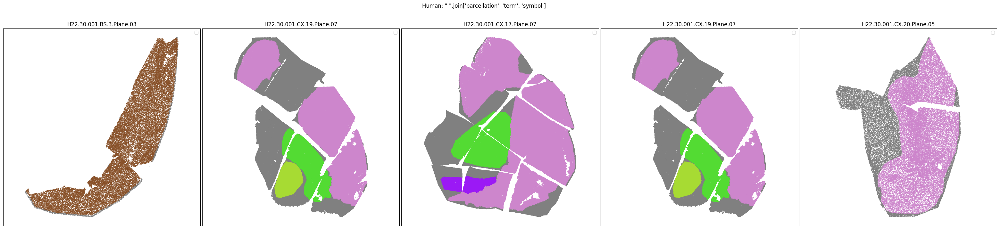

In [26]:
human_slab_list = [
    'H22.30.001.BS.3.Plane.03', 'H22.30.001.CX.19.Plane.07', 'H22.30.001.CX.17.Plane.07',
    'H22.30.001.CX.19.Plane.07', 'H22.30.001.CX.20.Plane.05'
]
color_type = 'parcellation_term_symbol_color'
fig, ax = plot_slabs(
    human_cell_metadata,
    color_type,
    human_slab_list,
    species='human',
    plot_polygons=False
)
fig.suptitle(f'Human: " ".join{color_type.split("_")[0:-1]}')
plt.show()

/tmp/ipykernel_2719/2680380787.py:83: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[idx].legend(loc=0)


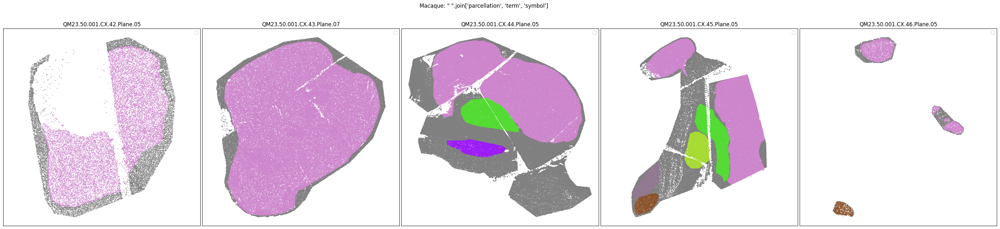

In [27]:
macaque_slab_list = [
    'QM23.50.001.CX.42.Plane.05', 'QM23.50.001.CX.43.Plane.07', 'QM23.50.001.CX.44.Plane.05',
    'QM23.50.001.CX.45.Plane.05', 'QM23.50.001.CX.46.Plane.05'
]
color_type = 'parcellation_term_symbol_color'
fig, ax = plot_slabs(
    macaque_cell_metadata,
    color_type,
    macaque_slab_list,
    species='macaque',
    plot_polygons=False
)
fig.suptitle(f'Macaque: " ".join{color_type.split("_")[0:-1]}')
plt.show()

/tmp/ipykernel_2719/2680380787.py:83: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[idx].legend(loc=0)


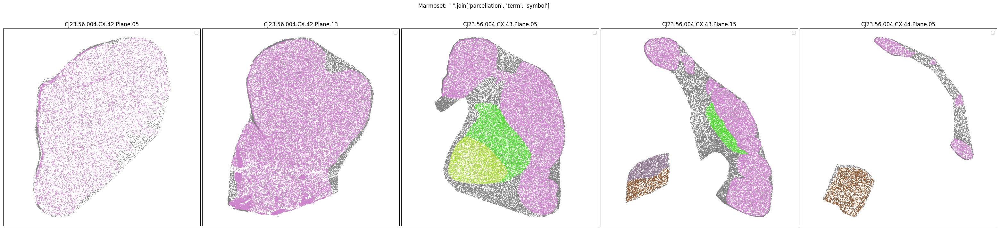

In [28]:
marmoset_slab_list = [
    'CJ23.56.004.CX.42.Plane.05', 'CJ23.56.004.CX.42.Plane.13', 'CJ23.56.004.CX.43.Plane.05',
    'CJ23.56.004.CX.43.Plane.15', 'CJ23.56.004.CX.44.Plane.05'
]
color_type = 'parcellation_term_symbol_color'
fig, ax = plot_slabs(
    marmoset_cell_metadata,
    color_type,
    marmoset_slab_list,
    species='marmoset',
    plot_polygons=False
)
fig.suptitle(f'Marmoset: " ".join{color_type.split("_")[0:-1]}')
plt.show()

## Taxonmy mapping

Now that we have our base functions for plotting set up, let's load the taxonomy information so that we can plot the spatial locations of various cell types. Below, we load and merge all the information we need to plot cell colors and taxonomy as done in previous HMBA tutorials.

In [29]:
cluster = abc_cache.get_metadata_dataframe(
    directory='HMBA-BG-taxonomy-CCN20250428',
    file_name='cluster',
    dtype={'number_of_cells': 'Int64'}
).rename(columns={'label': 'cluster_annotation_term_label'}).set_index('cluster_annotation_term_label')
cluster_annotation_term_set = abc_cache.get_metadata_dataframe(
    directory='HMBA-BG-taxonomy-CCN20250428',
    file_name='cluster_annotation_term_set'
).rename(columns={'label': 'cluster_annotation_term_label'})

cluster_annotation_term = abc_cache.get_metadata_dataframe(
    directory='HMBA-BG-taxonomy-CCN20250428',
    file_name='cluster_annotation_term',
).rename(columns={'label': 'cluster_annotation_term_label'}).set_index('cluster_annotation_term_label')
cluster_annotation_term_with_cells = cluster_annotation_term.join(cluster, how='left')

cluster_to_cluster_annotation_membership = abc_cache.get_metadata_dataframe(
    directory='HMBA-BG-taxonomy-CCN20250428',
    file_name='cluster_to_cluster_annotation_membership',
).set_index('cluster_annotation_term_label')
membership_with_cluster_info = cluster_to_cluster_annotation_membership.join(cluster_annotation_term_with_cells, rsuffix='_anno_term').reset_index()
membership_groupby = membership_with_cluster_info.groupby(
    ['cluster_alias', 'cluster_annotation_term_set_name']
)

cluster_annotation_term_set = abc_cache.get_metadata_dataframe(
    directory='HMBA-BG-taxonomy-CCN20250428',
    file_name='cluster_annotation_term_set'
).rename(columns={'label': 'cluster_annotation_term_label'})

# term_sets = abc_cache.get_metadata_dataframe(directory='WHB-taxonomy', file_name='cluster_annotation_term_set').set_index('label')
cluster_details = membership_groupby['cluster_annotation_term_name'].first().unstack()
cluster_order = membership_groupby['term_order'].first().unstack()
cluster_order.sort_values(['Neighborhood', 'Class', 'Subclass', 'Group', 'Cluster'], inplace=True)
cluster_order.rename(
    columns={'Neighborhood': 'Neighborhood_order',
             'Class': 'Class_order',
             'Subclass': 'Subclass_order',
             'Group': 'Group_order',
             'Cluster': 'Cluster_order'},
    inplace=True
)

cluster_colors = membership_groupby['color_hex_triplet'].first().unstack()
cluster_colors = cluster_colors[cluster_annotation_term_set['name']]
cluster_colors.sort_values(
    ['Neighborhood', 'Class', 'Subclass', 'Group', 'Cluster'],
    inplace=True
)

Each of the three species gene expression has been mapped to the HMBA 10X taxonomy using MapMyCells. Below we load these data for each species. For each cell, not only do these tables include cell mapping, but also statistics reporting the quality of the mapping.

In [30]:
# human_mmc = abc_cache.get_metadata_dataframe(
#     directory='HMBA-MERSCOPE-H22.30.001-BG',
#     file_name='mmc_taxonomy_mapping',
#     comment='#',
# ).rename(columns={'cell_id': 'cell_label'}).set_index('cell_label')
# human_mmc.head()
human_cell_to_cluster = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-H22.30.001-BG',
    file_name='cell_to_cluster_membership_hmba-bg-20250428'
).set_index('cell_label')

Merge the mmc and cluster information into the human cell metadata.

In [31]:
def fill_adjacent_data(input_df):
    return input_df.fillna(
        {'cluster_alias': 'Adjacent',
         'cluster_label': 'Adjacent',
         'Class': 'Adjacent',
         'Cluster': 'Adjacent',
         'Group': 'Adjacent',
         'Neighborhood': 'Adjacent',
         'Subclass': 'Adjacent',
         'Neighborhood_color': '#808080',
         'Class_color': '#808080',
         'Subclass_color': '#808080',
         'Group_color': '#808080',
         'Cluster_color': '#808080',
         'Neighborhood_order': cluster_order.max()['Neighborhood_order'] + 1,
         'Class_order': cluster_order.max()['Class_order'] + 1,
         'Subclass_order': cluster_order.max()['Subclass_order'] + 1,
         'Group_order': cluster_order.max()['Group_order'] + 1,
         'Cluster_order': cluster_order.max()['Cluster_order'] + 1,
        }
    )

In [32]:
human_cell_metadata = human_cell_metadata.join(human_cell_to_cluster)
human_cell_metadata = human_cell_metadata.join(cluster_details, on='cluster_alias')
human_cell_metadata = human_cell_metadata.join(cluster_colors, on='cluster_alias', rsuffix='_color')
human_cell_metadata = human_cell_metadata.join(cluster_order, on='cluster_alias')
human_cell_metadata = fill_adjacent_data(human_cell_metadata)
human_cell_metadata

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,abc_atlas_visualization,dataset_label,feature_matrix_label,brain_section_barcode_specimen,brain_section_thickness,...,Neighborhood_color,Class_color,Subclass_color,Group_color,Cluster_color,Class_order,Cluster_order,Group_order,Neighborhood_order,Subclass_order
cell_label,,,,,,,,,,,,,,,,,,,,,
1321115602_1-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,3285.3843,336.96967,False,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1321115602,10,...,#a8afa5,#594a26,#CCA43D,#CCA43D,#547f0c,3.0,220.0,13.0,1.0,9.0
1321115602_2-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,4730.3096,354.69010,False,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1321115602,10,...,#19613b,#d0b83c,#253c8c,#5713c3,#84c5ec,10.0,1294.0,56.0,3.0,32.0
1321115602_3-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,2966.4824,804.66986,False,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1321115602,10,...,#91f4bb,#0433b4,#77f0ca,#3EC918,#21a97d,6.0,456.0,24.0,2.0,16.0
1321115602_4-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,3765.8542,704.11170,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1321115602,10,...,#a8afa5,#a8afa5,#66493D,#66493D,#6e0e16,4.0,238.0,14.0,1.0,10.0
1321115602_5-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,3763.5205,716.22940,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1321115602,10,...,#a8afa5,#a8afa5,#B97300,#B97300,#1665ee,4.0,262.0,15.0,1.0,11.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1384732991_83878-20250227,H22.30.001.CX.20.02.05.01,1384732991,sis_cellpose_v1,6977.4614,11382.55800,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1384732991,14,...,#a8afa5,#594a26,#594a26,#66391F,#a9de1a,3.0,142.0,9.0,1.0,7.0
1384732991_83879-20250227,H22.30.001.CX.20.02.05.01,1384732991,sis_cellpose_v1,6978.6284,11390.16900,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1384732991,14,...,#a8afa5,#594a26,#594a26,#66391F,#a9de1a,3.0,142.0,9.0,1.0,7.0
1384732991_83880-20250227,H22.30.001.CX.20.02.05.01,1384732991,sis_cellpose_v1,6987.9976,11389.19200,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,1384732991,14,...,#a8afa5,#594a26,#594a26,#66391F,#a9de1a,3.0,142.0,9.0,1.0,7.0


Load the Macaque and Marmoset data in the same way.

In [33]:
macaque_cell_to_cluster = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-QM23.50.001-BG',
    file_name='cell_to_cluster_membership_hmba-bg-20250428',
).set_index('cell_label')

macaque_cell_metadata = macaque_cell_metadata.join(macaque_cell_to_cluster)
macaque_cell_metadata = macaque_cell_metadata.join(cluster_details, on='cluster_alias')
macaque_cell_metadata = macaque_cell_metadata.join(cluster_colors, on='cluster_alias', rsuffix='_color')
macaque_cell_metadata = macaque_cell_metadata.join(cluster_order, on='cluster_alias')
macaque_cell_metadata = fill_adjacent_data(macaque_cell_metadata)
macaque_cell_metadata.head()

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,abc_atlas_visualization,dataset_label,feature_matrix_label,brain_section_barcode_specimen,brain_section_thickness,...,Neighborhood_color,Class_color,Subclass_color,Group_color,Cluster_color,Class_order,Cluster_order,Group_order,Neighborhood_order,Subclass_order
cell_label,,,,,,,,,,,,,,,,,,,,,
1291813781_1-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6328.8564,271.71730,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,1291813781,10,...,#19613b,#d0b83c,#253c8c,#ff9896,#681364,10.0,1289.0,55.0,3.0,32.0
1291813781_2-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6313.3560,297.27830,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,1291813781,10,...,#a8afa5,#a8afa5,#66493D,#66493D,#e86aa0,4.0,246.0,14.0,1.0,10.0
1291813781_3-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6323.7240,297.38340,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,1291813781,10,...,#a8afa5,#995C60,#CC887A,#CC887A,#c79107,2.0,126.0,5.0,1.0,4.0
1291813781_4-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6370.7470,377.92710,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,1291813781,10,...,#a8afa5,#995C60,#5A662E,#5A662E,#eb2f3c,2.0,137.0,6.0,1.0,5.0
1291813781_5-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6375.0240,386.81006,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,1291813781,10,...,#a8afa5,#a8afa5,#a8afa5,#a8afa5,#f16ebe,4.0,288.0,17.0,1.0,13.0


In [34]:
marmoset_cell_to_cluster = abc_cache.get_metadata_dataframe(
    directory='HMBA-Xenium-CJ23.56.004-BG',
    file_name='cell_to_cluster_membership_hmba-bg-20250428',
).set_index('cell_label')

marmoset_cell_metadata = marmoset_cell_metadata.join(marmoset_cell_to_cluster)
marmoset_cell_metadata = marmoset_cell_metadata.join(cluster_details, on='cluster_alias')
marmoset_cell_metadata = marmoset_cell_metadata.join(cluster_colors, on='cluster_alias', rsuffix='_color')
marmoset_cell_metadata = marmoset_cell_metadata.join(cluster_order, on='cluster_alias')
marmoset_cell_metadata = fill_adjacent_data(marmoset_cell_metadata)
marmoset_cell_metadata.head()

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,abc_atlas_visualization,dataset_label,feature_matrix_label,brain_section_barcode_specimen,brain_section_thickness,...,Neighborhood_color,Class_color,Subclass_color,Group_color,Cluster_color,Class_order,Cluster_order,Group_order,Neighborhood_order,Subclass_order
cell_label,,,,,,,,,,,,,,,,,,,,,
1382042951_abmkfncc-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,5923.492676,6160.654297,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,1382042951,10,...,#a8afa5,#594a26,#594a26,#66391F,#5a9ad6,3.0,158.0,9.0,1.0,7.0
1382042951_abmmdgea-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,6137.572266,6217.075684,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,1382042951,10,...,#a8afa5,#401e66,#401e66,#195f8d,#9c3de0,1.0,36.0,1.0,1.0,1.0
1382042951_abmojfce-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,5802.674805,5614.007812,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,1382042951,10,...,#a8afa5,#401e66,#564860,#564860,#f12367,1.0,81.0,3.0,1.0,2.0
1382042951_abmomnim-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,5805.942383,5599.325684,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,1382042951,10,...,#a8afa5,#401e66,#564860,#564860,#82d054,1.0,84.0,3.0,1.0,2.0
1382042951_aeiamgga-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,6291.268066,6068.720215,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,1382042951,10,...,#a8afa5,#594a26,#594a26,#66391F,#5a9ad6,3.0,158.0,9.0,1.0,7.0


In [35]:
mouse_mmc = abc_cache.get_metadata_dataframe(
    directory='HMBA-Zhuang-ABCA-BG',
    file_name='mmc_taxonomy_mapping',
    comment='#',
).rename(columns={'cell_id': 'cell_label'}).set_index('cell_label')

mouse_cell_metadata = mouse_cell_metadata.join(mouse_mmc)
mouse_cell_metadata = mouse_cell_metadata.join(cluster_details, on='Cluster_alias')
mouse_cell_metadata = mouse_cell_metadata.join(cluster_colors, on='Cluster_alias', rsuffix='_color')
mouse_cell_metadata = mouse_cell_metadata.join(cluster_order, on='Cluster_alias')
mouse_cell_metadata.head()

,brain_section_label,feature_matrix_label,donor_label,donor_genotype,donor_sex,cluster_alias,x,y,z,subclass_confidence_score,...,Neighborhood_color,Class_color,Subclass_color,Group_color,Cluster_color,Class_order,Cluster_order,Group_order,Neighborhood_order,Subclass_order
cell_label,,,,,,,,,,,,,,,,,,,,,
140326997007540545632825561480074910925,Zhuang-ABCA-1.089,Zhuang-ABCA-1-BG,Zhuang-ABCA-1,wt/wt,F,5231,3.856600,4.843804,7.82953,0.999973,...,#a8afa5,#594a26,#594a26,#66391F,#a9de1a,3,142,9,1,7
189072533119855038043895242178779700246,Zhuang-ABCA-1.089,Zhuang-ABCA-1-BG,Zhuang-ABCA-1,wt/wt,F,5231,3.860636,4.911333,7.82953,0.999984,...,#a8afa5,#594a26,#594a26,#594a26,#16cece,3,176,10,1,7
209727608826968156867849253723759432014,Zhuang-ABCA-1.089,Zhuang-ABCA-1-BG,Zhuang-ABCA-1,wt/wt,F,5254,3.833809,4.825046,7.82953,0.999982,...,#a8afa5,#a8afa5,#66493D,#66493D,#6e0e16,4,238,14,1,10
256350117171596137374760944717720346108,Zhuang-ABCA-1.089,Zhuang-ABCA-1-BG,Zhuang-ABCA-1,wt/wt,F,5254,3.835581,4.866399,7.82953,0.999975,...,#a8afa5,#a8afa5,#66493D,#66493D,#1bf6d7,4,253,14,1,10
67350765359712588341770079705746198475,Zhuang-ABCA-1.089,Zhuang-ABCA-1-BG,Zhuang-ABCA-1,wt/wt,F,5231,3.851189,4.840811,7.82953,0.999986,...,#a8afa5,#594a26,#594a26,#66391F,#a5e9f2,3,149,9,1,7


### Plotting the taxonomy

Now that the taxonomy and spatial data are loaded, we plot the the cells showing the spatial locations of the cell types in the Basal Ganglia. Below we plot each species in the dataset for each of the 5 levels in the taxonomy. We select a set of slab planes that traverses through the data. As we step through each slab plane, we can see the outline of the Basal Ganglia in the various cell types, helped by the polygons of the various BG regions.

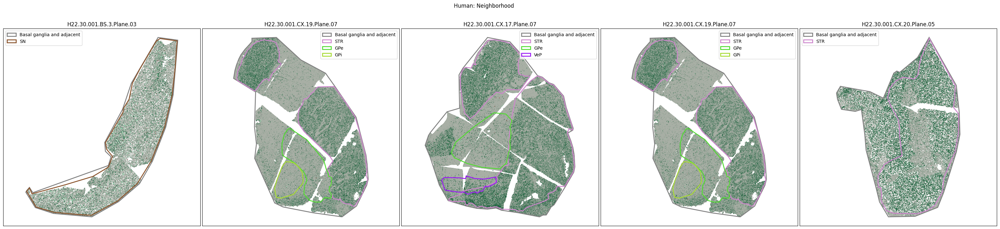

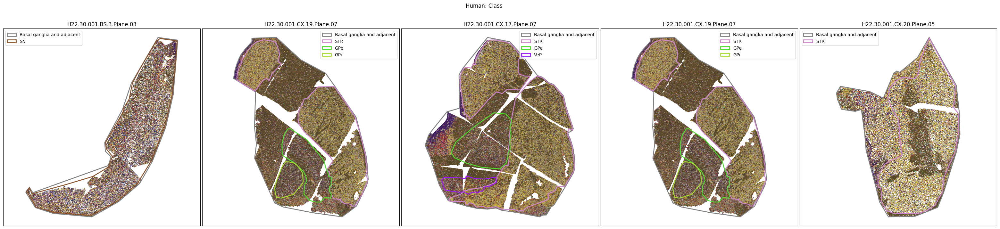

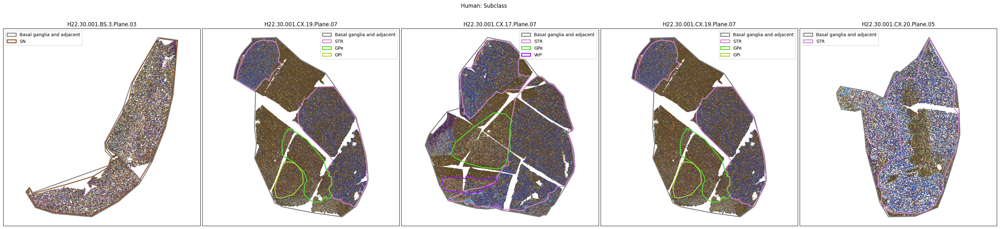

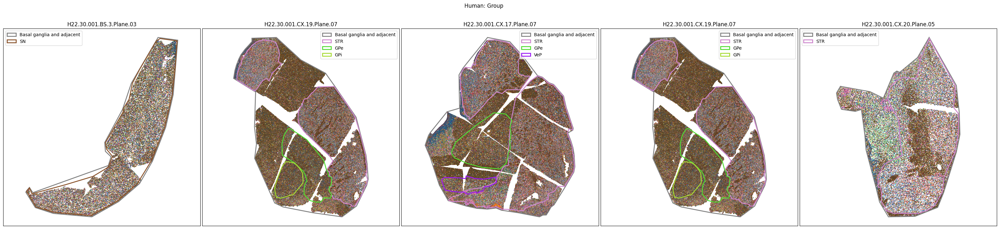

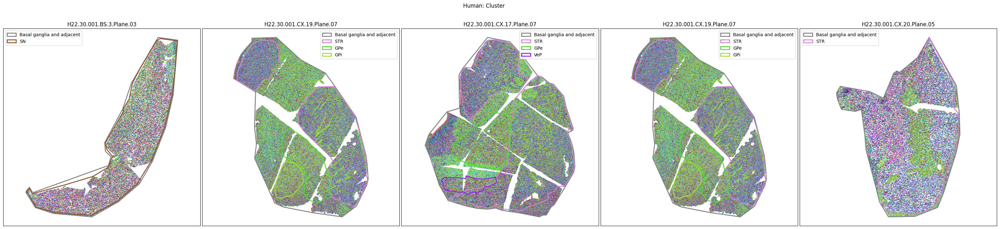

In [36]:
human_slab_list = [
    'H22.30.001.BS.3.Plane.03', 'H22.30.001.CX.19.Plane.07', 'H22.30.001.CX.17.Plane.07',
    'H22.30.001.CX.19.Plane.07', 'H22.30.001.CX.20.Plane.05'
]
for color_type in ['Neighborhood_color', 'Class_color', 'Subclass_color', 'Group_color', 'Cluster_color']:
    fig, ax = plot_slabs(
        human_cell_metadata,
        color_type,
        human_slab_list,
        species='human',
        plot_polygons=True
    )
    fig.suptitle(f'Human: {color_type.split("_")[0]}')
    plt.show()

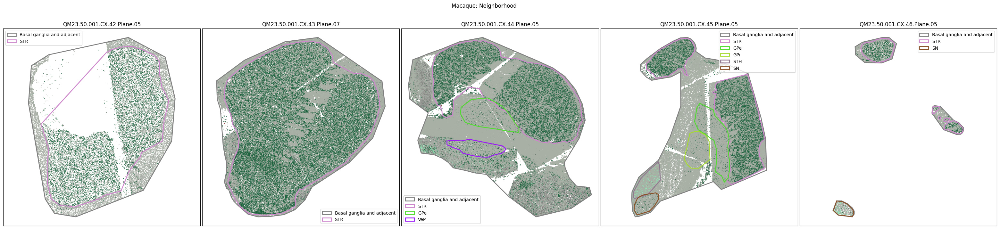

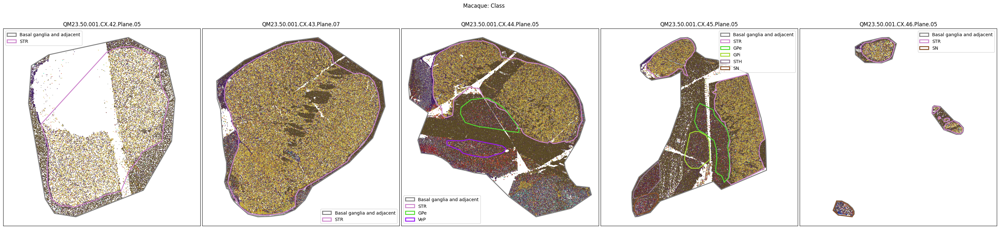

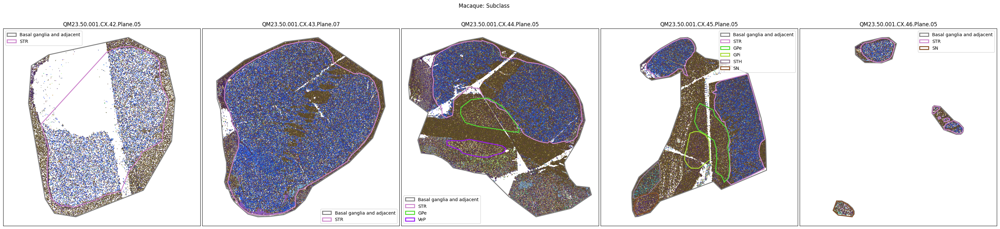

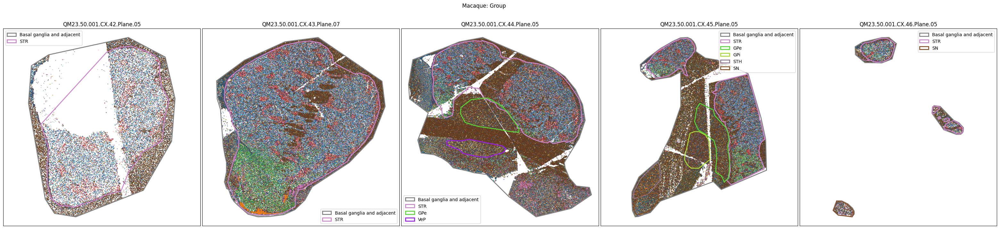

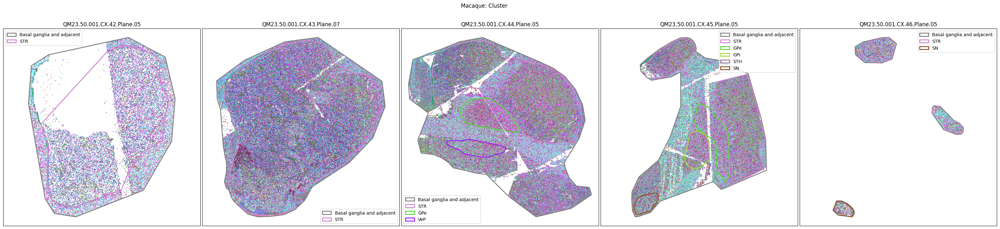

In [37]:
macaque_slab_list = [
    'QM23.50.001.CX.42.Plane.05', 'QM23.50.001.CX.43.Plane.07', 'QM23.50.001.CX.44.Plane.05',
    'QM23.50.001.CX.45.Plane.05', 'QM23.50.001.CX.46.Plane.05'
]
for color_type in ['Neighborhood_color', 'Class_color', 'Subclass_color', 'Group_color', 'Cluster_color']:
    fig, ax = plot_slabs(
        macaque_cell_metadata,
        color_type,
        macaque_slab_list,
        species='macaque',
        plot_polygons=True
    )
    fig.suptitle(f'Macaque: {color_type.split("_")[0]}')
    plt.show()

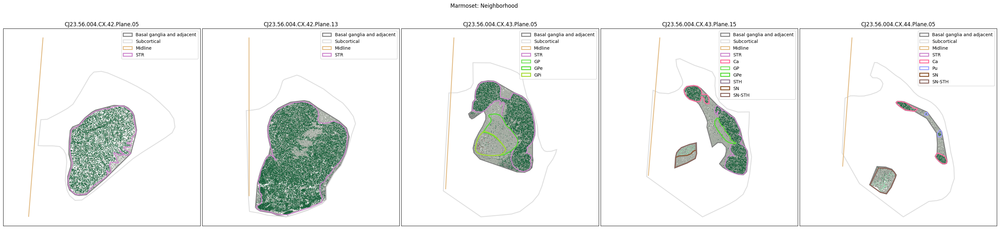

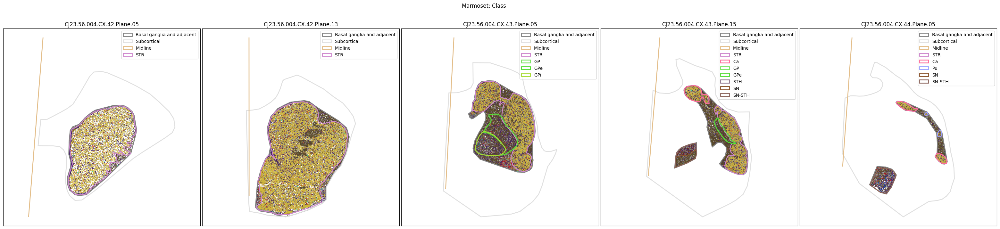

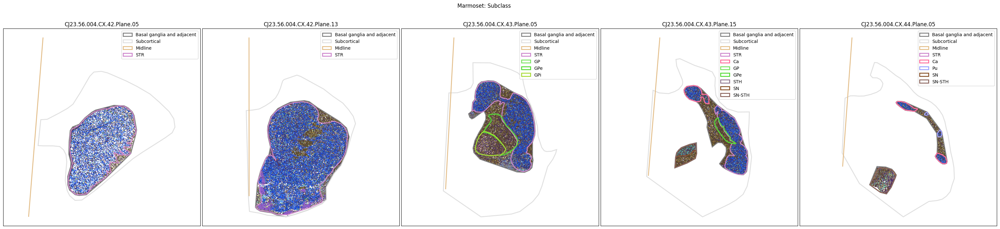

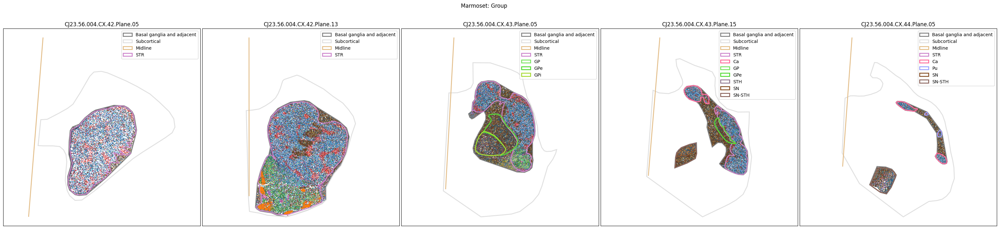

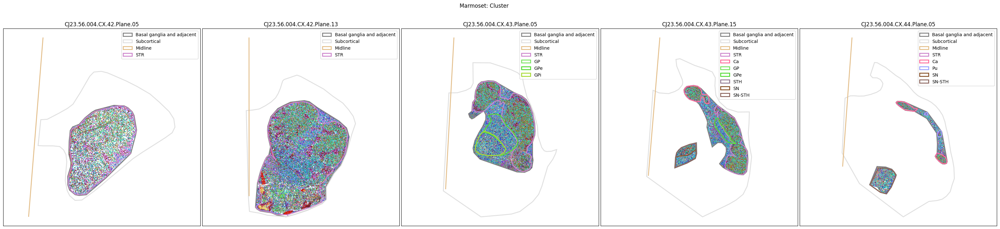

In [38]:
marmoset_slab_list = [
    'CJ23.56.004.CX.42.Plane.05', 'CJ23.56.004.CX.42.Plane.13', 'CJ23.56.004.CX.43.Plane.05',
    'CJ23.56.004.CX.43.Plane.15', 'CJ23.56.004.CX.44.Plane.05'
]
for color_type in ['Neighborhood_color', 'Class_color', 'Subclass_color', 'Group_color', 'Cluster_color']:
    fig, ax = plot_slabs(
        marmoset_cell_metadata,
        color_type,
        marmoset_slab_list,
        species='marmoset',
        plot_polygons=True
    )
    fig.suptitle(f'Marmoset: {color_type.split("_")[0]}')
    plt.show()

/tmp/ipykernel_2719/2680380787.py:83: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[idx].legend(loc=0)


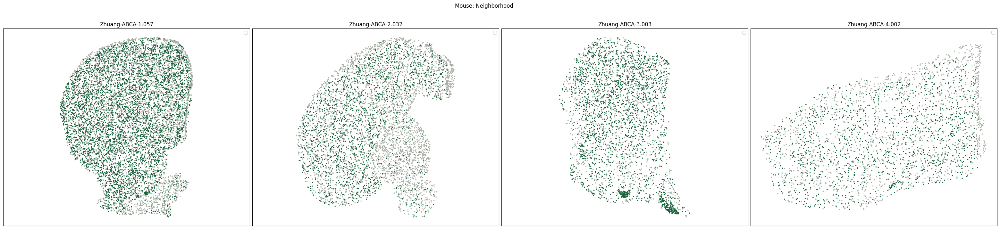

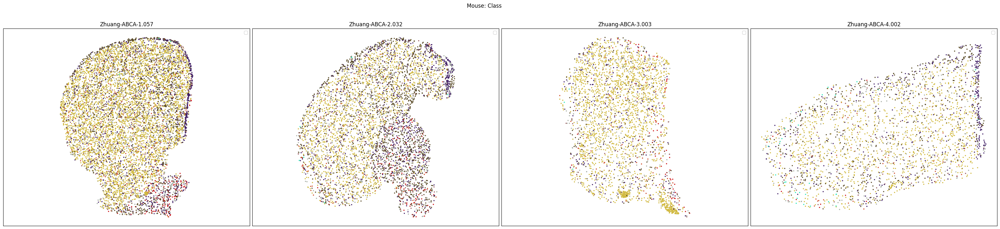

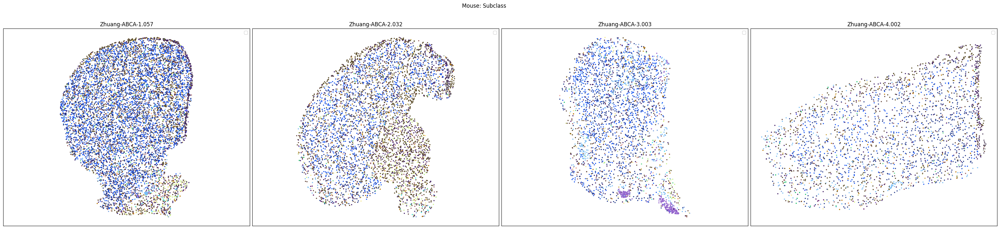

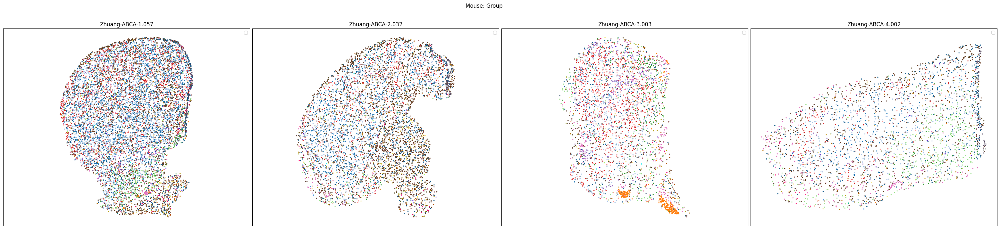

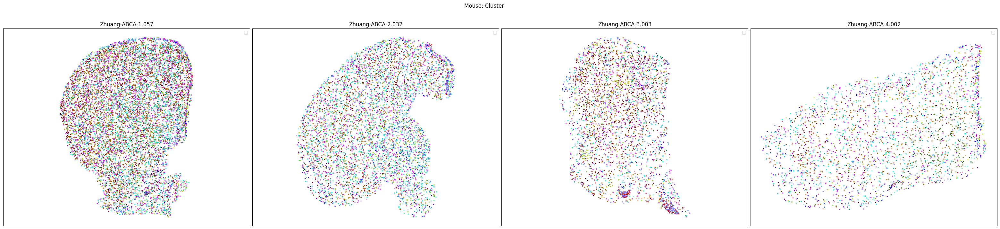

In [39]:
mouse_slab_list = [
    'Zhuang-ABCA-1.057', 'Zhuang-ABCA-2.032',
    'Zhuang-ABCA-3.003', 'Zhuang-ABCA-4.002'
]
for color_type in ['Neighborhood_color', 'Class_color', 'Subclass_color', 'Group_color', 'Cluster_color']:
    fig, ax = plot_slabs(
        mouse_cell_metadata,
        color_type,
        mouse_slab_list,
        species='mouse',
        plot_polygons=False,
        point_size=10.0,
    )
    fig.suptitle(f'Mouse: {color_type.split("_")[0]}')
    plt.show()

### Selecting celltypes

We define a slightly modified version of our slab plotting function that allows us to plot specific cell types that we specify in via the `selection_list` variable.

In [40]:
def plot_selected_celltype(
    df,
    feature,
    selection_list,
    slab,
    species,
    cmap=None,
    fig_width=40,
    fig_height=8,
    plot_polygons=True,
    point_size=1.0,
    fix_bounds=False
):
    """Plot spatial transcriptomics data selected by given celltypes.

    Parameters
    ----------
    df: pandas.DataFrame
        cell metadata data frame with x,y locations to plot.
    feature: str
        Expression value or color column to plot.
    selection_list: List[str]
        Set of cell types to select by. Specify as ('taxonomy_level_name', 'celltype')
    slab: str
        Specific slab to plot.
    species: str
        Species to plot (human, macaque, marmoset).
    cmap: matplotlib.colors.Colormap
        Colormap for expression features.
    fid_width: int
        Width of the plotted figure.
    fig_height: iont
        Height of the plotted figure.
    plot_polygons: bool
        Overplot geojson polygons. Note that these are note available for human
        and this should be set to False.
    """
    
    fig, ax = plt.subplots(1, len(selection_list))
    fig.set_size_inches(fig_width, fig_height)

    if 'slab_plane_label' in df.columns:
        slab_filtered = df[df['slab_plane_label']==slab]
    elif 'brain_section_label' in df.columns:
        slab_filtered = df[df['brain_section_label']==slab]

    if 'x' in df.columns:
        x_col = 'x'
    elif 'x_slab_mm' in df.columns:
        x_col = 'x_slab_mm'
    if 'y' in df.columns:
        y_col = 'y'
    elif 'y_slab_mm' in df.columns:
        y_col = 'y_slab_mm'

    if fix_bounds:
        x_min = slab_filtered[x_col].min()
        x_max = slab_filtered[x_col].max()
        y_min = slab_filtered[y_col].min()
        y_max = slab_filtered[y_col].max()
    
    for idx, (col, name) in enumerate(selection_list):

        if 'slab_plane_label' in df.columns:
            filtered = slab_filtered[slab_filtered[col]==name]
        elif 'brain_section_label' in df.columns:
            filtered = slab_filtered[slab_filtered[col]==name]
        xx = filtered[x_col]
        yy = filtered[y_col]
        vv = filtered[feature]
        
        if cmap is not None:
            ax[idx].scatter(xx, yy, s=point_size, c=vv, marker='.', cmap=cmap)
        else :
            ax[idx].scatter(xx, yy, s=point_size, c=vv, marker=".")

        if plot_polygons:
            plot_geo_data(get_polygons(slab, species=species), ax[idx])
            
        ax[idx].axis('equal')
        ylim = ax[idx].get_ylim()
        if fix_bounds:
            ylim = (y_min, y_max)
            ax[idx].set_xlim(x_min, x_max)
        ax[idx].set_ylim(ylim[1], ylim[0])
        ax[idx].set_xticks([])
        ax[idx].set_yticks([])
        
        ax[idx].set_title(name)
        ax[idx].legend(loc=0)
        
    plt.subplots_adjust(wspace=0.01, hspace=0.01)
    fig.suptitle(f'{species}, {slab}')
    return fig, ax

Using the above function, we plot the cells colored by their Group and selecting by specific classes and subclasses. This shows us the distribution of specific cell types in the BG.

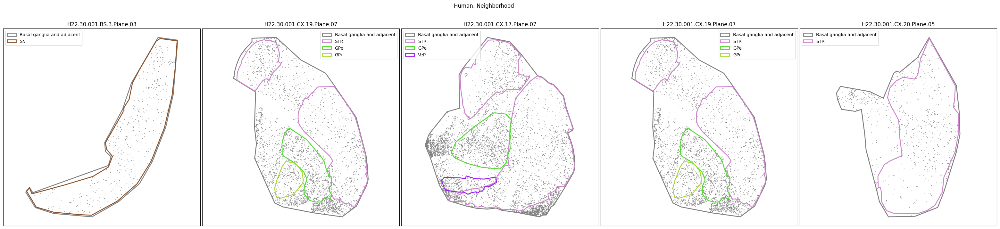

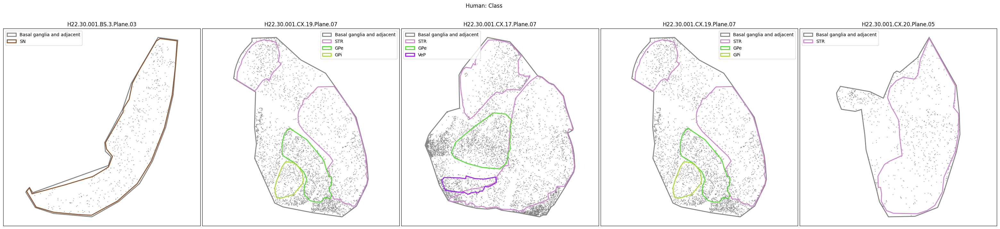

In [ ]:
human_slab_list = [
    'H22.30.001.BS.3.Plane.03', 'H22.30.001.CX.19.Plane.07', 'H22.30.001.CX.17.Plane.07',
    'H22.30.001.CX.19.Plane.07', 'H22.30.001.CX.20.Plane.05'
]
for slab in mouse_slab_list:
    fig, ax = plot_selected_celltype(
        human_cell_metadata,
        feature='Group_color',
        selection_list=[
            ('Class', 'CN LGE GABA'),
            ('Subclass', 'STR D1 MSN'),
            ('Subclass', 'STR D2 MSN'),
            ('Subclass', 'STR Hybrid MSN'),
            ('Subclass', 'OT Granular GABA')
        ],
        slab=slab,
        species='human',
        fig_width=30,
        fig_height=6,
        plot_polygons=False,
        point_size=10,
        fix_bounds=True
    )
    fig, ax = plot_slabs(
        human_cell_metadata[human_cell_metadata['Neighborhood'] == 'Adjacent'],
        color_type,
        human_slab_list,
        species='human',
        plot_polygons=True
    )
    fig.suptitle(f'Human: {color_type.split("_")[0]}')
    plt.show()

In [ ]:
macaque_slab_list = [
    'QM23.50.001.CX.42.Plane.05', 'QM23.50.001.CX.43.Plane.07', 'QM23.50.001.CX.44.Plane.05',
    'QM23.50.001.CX.45.Plane.05', 'QM23.50.001.CX.46.Plane.05'
]
for color_type in ['Neighborhood_color', 'Class_color', 'Subclass_color', 'Group_color', 'Cluster_color']:
    fig, ax = plot_slabs(
        macaque_cell_metadata[macaque_cell_metadata['Neighborhood'] == 'Adjacent'],
        color_type,
        macaque_slab_list,
        species='macaque',
        plot_polygons=True
    )
    fig.suptitle(f'Macaque: {color_type.split("_")[0]}')
    plt.show()

In [ ]:
marmoset_slab_list = [
    'CJ23.56.004.CX.42.Plane.05', 'CJ23.56.004.CX.42.Plane.13', 'CJ23.56.004.CX.43.Plane.05',
    'CJ23.56.004.CX.43.Plane.15', 'CJ23.56.004.CX.44.Plane.05'
]
for color_type in ['Neighborhood_color', 'Class_color', 'Subclass_color', 'Group_color', 'Cluster_color']:
    fig, ax = plot_slabs(
        marmoset_cell_metadata[marmoset_cell_metadata['Neighborhood'] == 'Adjacent'],
        color_type,
        marmoset_slab_list,
        species='marmoset',
        plot_polygons=True
    )
    fig.suptitle(f'Marmoset: {color_type.split("_")[0]}')
    plt.show()

In [ ]:
for slab in mouse_slab_list:
    fig, ax = plot_selected_celltype(
        mouse_cell_metadata,
        feature='Group_color',
        selection_list=[
            ('Class', 'CN LGE GABA'),
            ('Subclass', 'STR D1 MSN'),
            ('Subclass', 'STR D2 MSN'),
            ('Subclass', 'STR Hybrid MSN'),
            ('Subclass', 'OT Granular GABA')
        ],
        slab=slab,
        species='mouse',
        fig_width=30,
        fig_height=6,
        plot_polygons=False,
        point_size=10,
        fix_bounds=True
    )

In [ ]:
mouse_cell_metadata = mouse_cell_metadata.join(parcellation_annotation, on='parcellation_index')
mouse_cell_metadata = mouse_cell_metadata.join(parcellation_color, on='parcellation_index')

In [ ]:
mouse_slab_list = [
    'Zhuang-ABCA-1.057', 'Zhuang-ABCA-2.032',
    'Zhuang-ABCA-3.003', 'Zhuang-ABCA-4.002'
]
for color_type in ['parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color']:
    fig, ax = plot_slabs(
        mouse_cell_metadata,
        color_type,
        mouse_slab_list,
        species='mouse',
        plot_polygons=False,
        point_size=10.0
    )
    fig.suptitle(f'Mouse: {color_type}')
    plt.show()

In [ ]:
for slab in human_slab_list:
    fig, ax = plot_selected_celltype(
        human_cell_metadata,
        feature='Cluster_color',
        selection_list=[
            ('Neighborhood', 'Adjacent'),
            ('Class', 'Adjacent'),
            ('Subclass', 'Adjacent'),
            ('Group', 'Adjacent'),
            ('Cluster', 'Adjacent')
        ],
        slab=slab,
        species='human',
        fig_width=25,
        fig_height=5,
        plot_polygons=True
    )

In [ ]:
for slab in macaque_slab_list:
    fig, ax = plot_selected_celltype(
        macaque_cell_metadata,
        feature='Cluster_color',
        selection_list=[
            ('Neighborhood', 'Adjacent'),
            ('Class', 'Adjacent'),
            ('Subclass', 'Adjacent'),
            ('Group', 'Adjacent'),
            ('Cluster', 'Adjacent')
        ],
        slab=slab,
        species='macaque',
        fig_width=25,
        fig_height=5,
        plot_polygons=True
    )

In [ ]:
for slab in marmoset_slab_list:
    fig, ax = plot_selected_celltype(
        marmoset_cell_metadata,
        feature='Cluster_color',
        selection_list=[
            ('Neighborhood', 'Adjacent'),
            ('Class', 'Adjacent'),
            ('Subclass', 'Adjacent'),
            ('Group', 'Adjacent'),
            ('Cluster', 'Adjacent')
        ],
        slab=slab,
        species='marmoset',
        fig_width=30,
        fig_height=6,
        plot_polygons=True
    )